<img src="https://www.globallogic.com/de/wp-content/uploads/sites/26/2019/10/Machine-Learning.jpg">

<br><br>

<H2><B> Análisis exploratorio de documentos de texto mediante LSA </B></H2>
<br><br>
<H3><I> Ismael Medina Muñoz </I></H3>

---


# Introducción
En el presente experimento se mostrará el código y los resultados de aplicar el Latent Semantic Analysis a texto de twits humorísticos.

# Análisis

## Carga del conjunto de datos
Para este experimento, el conjunto de datos será el de `humor.csv` para el análisis de temas por clase **klass** (joke, no-joke), **humor_mechanish** y **humor_rating** (opcional). Aquí se optó por hacer el procesamiento sobre **humor_rating**.

In [1]:
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.stem import SnowballStemmer
from collections import Counter
from nltk.tokenize import TweetTokenizer
from sklearn.feature_extraction.text import  CountVectorizer
from matplotlib import pyplot as plt
from sklearn.decomposition import LatentDirichletAllocation as LDiA
from sklearn.decomposition import TruncatedSVD

import pandas as pd
import numpy as np
import unicodedata
import unidecode
import re
import wordcloud
import math

In [2]:
data = pd.read_csv("humor.csv",delimiter=',',index_col=0)
data = data.fillna(0)
data.head()

,text,klass,humor_rating,humor_mechanism
id,,,,
tweet1,Niveles de retraso mental: \n\n— Bajo.\n— Medi...,joke,1.5,0
tweet2,"—Vamos Luke desenfunda tu sable, demuestra tu ...",joke,1.5,0
tweet3,"- ¿Te ofrezco algo?, ¿Agua, café, mi corazón, ...",joke,2.6,0
tweet4,No se porqué me hago la cabeza deooos,no-joke,0.0,0
tweet5,Quisiera saber que hago durante la siesta de l...,no-joke,0.0,0


## Código reutilizable
El desarrollo del ejercicio se hará con código reutilizable que permitirá tener un documento de menor volumen y más fácilmente legible.

In [3]:
PUNCTUACTION = ";:,.\\-\"'/"
SYMBOLS = "()[]¿?¡!{}~<>|—&"
SKIP_SYMBOLS = set(PUNCTUACTION + SYMBOLS)
SKIP_SYMBOLS_AND_SPACES = set(PUNCTUACTION + SYMBOLS + '\t\n\r ')

print(SKIP_SYMBOLS_AND_SPACES)

{'\\', ',', '|', '(', '{', '\n', '¡', '"', '/', '}', "'", '<', ' ', ';', '¿', '\t', ':', '~', '.', '[', '&', '?', '!', '>', '-', '\r', '—', ')', ']'}


In [4]:
PUNCTUACTION = ";:,.\\-\"'/"
SYMBOLS = "()[]¿?¡!{}~<>|—●«»“”‟"
SKIP_SYMBOLS = set(PUNCTUACTION + SYMBOLS)
SKIP_SYMBOLS_AND_SPACES = set(PUNCTUACTION + SYMBOLS + '\t\n\r ')
cachedStopWords = [unidecode.unidecode(token) for token in stopwords.words('spanish')] 

def normalize_text(input_str,
                   punct=False,
                   accents=False,
                   stemming=True,
                   removeduplicated=True,
                   stopwords=False,
                   max_dup=2):
    
    identifica_repetido_3 = r"(\w)\1{2,}" ## más de 2 repeticiones se reducen a 1
    reemplaza_repetido_3 = r"\1"
    
    stemmer=SnowballStemmer("spanish")
    ## Uso de minusculas
    nfkd_f = unicodedata.normalize('NFKD', input_str.lower())
    if removeduplicated:
        nfkd_f = re.sub(identifica_repetido_3, reemplaza_repetido_3, nfkd_f)

    n_str = []
    c_prev = ''
    cc_prev = 0
    for c in nfkd_f:
        ## Elimina puntuación
        if not punct:
            if c in SKIP_SYMBOLS:
                continue
        if not accents and unicodedata.combining(c):
            continue
        if c_prev == c:
            cc_prev += 1
            if cc_prev >= max_dup:
                continue
        else:
            cc_prev = 0
        n_str.append(c)
        c_prev = c
   
    n_str = "".join(n_str)
    
    if not stopwords:
        tokens = n_str.split()
        otwit = [word for word in tokens if not word in cachedStopWords] 
        n_str = ' '.join(otwit)

    if stemming:
        tokens = n_str.split()
        stemmed_tokens = [stemmer.stem(token) for token in tokens]
        n_str = ' '.join(stemmed_tokens)
        
    return n_str

In [5]:
def custom_tokenizer(txt):
    return normalize_text(txt, stemming=False).split()

In [6]:
def vectorize_and_transform(df, column_class, text_column, vectorizer = CountVectorizer):
    vect = {}
    vect_2grams = {}
    
    trns = {} ##
    trns_2grams = {}##
    
    for current_class in df[column_class].unique():
        ## Filtramos la clase de interés
        current_df = df[df[column_class] == current_class]

        ## Generamos los vectorizadores
        current_vect = vectorizer(tokenizer=custom_tokenizer).fit(current_df[text_column])
        current_vect_2grams = vectorizer(tokenizer=custom_tokenizer, 
                                         ngram_range=(2,2)).fit(current_df[text_column])    

        ## Adición a los diccionarios
        vect[current_class] = current_vect
        trns[current_class] = current_vect.transform(current_df[text_column])
        vect_2grams[current_class] = current_vect_2grams
        trns_2grams[current_class] = current_vect_2grams.transform(current_df[text_column])

    ##trns = {}
    ##for k, v in vect.items():
    ##    trns[k] = v.transform(df[text_column])

    ##trns_2grams = {}
    ##for k, v in vect_2grams.items():
    ##    trns_2grams[k] = v.transform(df[text_column])

    return vect, trns, vect_2grams, trns_2grams

In [7]:
def top_words(vectorizer, transformation, top = 10, columns = 3, height = 10):
    rows = math.ceil(len(transformation.keys()) / columns)
    fig, axes = plt.subplots(nrows = rows, ncols = columns, figsize=(20, height))

    r = 0
    c = 0

    for k, v in transformation.items():
        sum_words=v.sum(axis=0)
        words_count = Counter(dict([(word, sum_words[0, idx]) for word, idx in vectorizer[k].vocabulary_.items()]))
        top_words=[x[0] for x in words_count.most_common(top)]

        try:
            if(rows > 1):
                axes[r, c].bar(range(top),[x[1] for x in words_count.most_common(top)])
                axes[r, c].set_xticks(ticks=range(len(top_words)))
                axes[r, c].set_xticklabels(labels=top_words,rotation='vertical', fontsize=20)
                axes[r, c].set_title(k, fontsize=30)
            else:
                axes[c].bar(range(top),[x[1] for x in words_count.most_common(top)])
                axes[c].set_xticks(ticks=range(len(top_words)))
                axes[c].set_xticklabels(labels=top_words,rotation='vertical', fontsize=20)
                axes[c].set_title(k, fontsize=30)

            c += 1
            if c > columns - 1:
                r += 1
                c = 0
        except:
            print("!", end = "")  

    fig.tight_layout()

In [8]:
def word_clouds(vectorizer, transformation, top = 100, columns = 3, height = 20):
    rows = math.ceil(len(transformation.keys()) / columns)
    fig, axes = plt.subplots(nrows = rows, ncols = columns, figsize=(20, height))

    r = 0
    c = 0

    for k, v in transformation.items():
        sum_words=v.sum(axis=0)
        words_count = Counter(dict([(word, sum_words[0, idx]) for word, idx in vectorizer[k].vocabulary_.items()]))
        wc=wordcloud.WordCloud()
        wc.generate_from_frequencies(dict(words_count.most_common(top)))

        try:
            if(rows > 1):
                axes[r, c].imshow(wc)
                axes[r, c].set_axis_off()
                axes[r, c].set_title(k, fontsize=30)
            else:
                axes[c].imshow(wc)
                axes[c].set_axis_off()
                axes[c].set_title(k, fontsize=30)

            c += 1
            if c > columns - 1:
                r += 1
                c = 0
        except:
            print("!", end = "")  

    fig.tight_layout()

In [9]:
def execute_LDiA (df, column_class, text_column, n_topics = 14, ngrams = 1):
    ## Generamos los vectorizadores
    if (ngrams > 1):
        vect = CountVectorizer(tokenizer=custom_tokenizer, 
                                 ngram_range=(ngrams, ngrams)).fit(df[text_column])
    else:
        vect = CountVectorizer(tokenizer=custom_tokenizer).fit(df[text_column])
    trns = vect.transform(df[text_column])

    terms = trns.toarray()
    ldia = LDiA(n_components=n_topics)
    ldia_transformation = ldia.fit_transform(terms)
    df_ldia = pd.DataFrame(ldia.components_.T, \
                           index=vect.vocabulary_.keys(), \
                           columns=['topic{}'.format(i+1) for i in range(n_topics)])
    
    return df_ldia, ldia_transformation

In [10]:
def execute_TruncatedSVD (df, column_class, text_column, n_topics = 14, ngrams = 1):
    ## Generamos los vectorizadores
    if (ngrams > 1):
        vect = TfidfVectorizer(tokenizer=custom_tokenizer, 
                                 ngram_range=(ngrams, ngrams)).fit(df[text_column])
    else:
        vect = TfidfVectorizer(tokenizer=custom_tokenizer).fit(df[text_column])
    trns = vect.transform(df[text_column])
    
    svd = TruncatedSVD(n_components=n_topics, n_iter=100)
    svd_transformation = svd.fit_transform(trns)

    df_svd = pd.DataFrame(svd.components_.T, \
                           index=vect.vocabulary_.keys(), \
                           columns=['topic{}'.format(i+1) for i in range(n_topics)])
    
    return df_svd, svd_transformation

In [11]:
def top_words_DF(df, top = 10, columns = 3, height = 30):
    rows = math.ceil(df.shape[1] / columns)
    fig, axes = plt.subplots(nrows = rows, ncols = columns, figsize=(20, height))

    r = 0
    c = 0

    for column in df:
        df_subset = df[column].sort_values(ascending=False)[:top]
        try:
            if(rows > 1):

                axes[r, c].bar(range(top), df_subset)
                axes[r, c].set_xticks(ticks=range(df_subset.shape[0]))
                axes[r, c].set_xticklabels(labels=df_subset.index,rotation='vertical', fontsize=20)
                axes[r, c].set_title(column, fontsize=30)
            else:
                axes[c].bar(range(top), df_subset)
                axes[c].set_xticks(ticks=range(df_subset.shape[0]))
                axes[c].set_xticklabels(labels=df_subset.index,rotation='vertical', fontsize=20)
                axes[c].set_title(column, fontsize=30)

            c += 1
            if c > columns - 1:
                r += 1
                c = 0
        except:
            print("!", end = "")  

    fig.tight_layout()        

In [12]:
def word_clouds_DF(df, top = 100, columns = 3, height = 25):
    rows = math.ceil(df.shape[1] / columns)
    fig, axes = plt.subplots(nrows = rows, ncols = columns, figsize=(20, height))

    r = 0
    c = 0

    for column in df:
        df_subset = df[column].sort_values(ascending=False)[:top]
        wc=wordcloud.WordCloud()
        wc.generate_from_frequencies(df_subset.to_dict())

        try:
            if(rows > 1):
                axes[r, c].imshow(wc)
                axes[r, c].set_axis_off()
                axes[r, c].set_title(column, fontsize=30)
            else:
                axes[c].imshow(wc)
                axes[c].set_axis_off()
                axes[c].set_title(column, fontsize=30)

            c += 1
            if c > columns - 1:
                r += 1
                c = 0
        except:
            print("!", end = "")  

    fig.tight_layout()     

En la celda anterior se observa que hay valores `NaN`. Estos valores no serán limpiados y simplemente se podrían excluir. Sin embargo, como parte del análisis exploratorio asignaremos el valor 0 a cada `NaN`.

## 1. Matriz de término - documento por clase, por humor_mechanism y por *humor_rating* (tf-idf y bag of words)

### Análisis exploratorio por conteos y limpieza de los datos
En las celdas posteriores haremos el conteo de los posibles documentos de los cuales haremos *BoWs* y *TF-IDF*. Los documentos serán las clases, mecanismo de humor y datos discretizados de ratings de humor.

In [13]:
print("Clases y su conteo: \n\n", data.klass.value_counts())

Clases y su conteo: 

 no-joke    14747
joke        9253
Name: klass, dtype: int64


In [14]:
print("Mecanismo de humor y su conteo:\n\n", data.humor_mechanism.value_counts())

Mecanismo de humor y su conteo:

 0                   19200
wordplay              701
reference             578
absurd                566
exaggeration          476
unmasking             441
misunderstanding      416
irony                 371
analogy               319
embarrassment         301
parody                255
stereotype            230
insults               146
Name: humor_mechanism, dtype: int64


In [15]:
print("Ratings de humor y su conteo: \n\n", data.humor_rating.value_counts())

Ratings de humor y su conteo: 

 0.000000    14747
2.000000     1205
1.000000      719
2.200000      445
3.000000      443
            ...  
2.684211        1
2.473684        1
1.352941        1
2.533333        1
1.300000        1
Name: humor_rating, Length: 221, dtype: int64


Para un mejor análisis se van a discretizar los ratings truncando los valores decimales.

In [16]:
data["discrete_humor_rating"] = np.trunc(data.humor_rating)

In [17]:
print("Ratings de humos y su conteo: \n\n", data.discrete_humor_rating.value_counts())

Ratings de humos y su conteo: 

 0.0    14747
2.0     4304
1.0     3965
3.0      951
4.0       33
Name: discrete_humor_rating, dtype: int64


### Bag of words

In [18]:
kl_v, kl_t, \
kl_v_2grams, kl_t_2grams = vectorize_and_transform(data, "klass", "text")

hm_v, hm_t, \
hm_v_2grams, hm_t_2grams = vectorize_and_transform(data, "humor_mechanism", "text")

hr_v, hr_t, \
hr_v_2grams, hr_t_2grams = vectorize_and_transform(data, "discrete_humor_rating", "text")

C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn("The parameter 'token_pattern' will not be used"
C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn("The parameter 'token_pattern' will not be used"
C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn("The parameter 'token_pattern' will not be used"
C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is

### TF - IDF

In [19]:
kl_v_tfidf, kl_t_tfidf, \
kl_v_2grams_tfidf, kl_t_2grams_tfidf = vectorize_and_transform(data, "klass", "text", TfidfVectorizer)

hm_v_tfidf, hm_t_tfidf, \
hm_v_2grams_tfidf, hm_t_2grams_tfidf = vectorize_and_transform(data, "humor_mechanism", "text", TfidfVectorizer)

hr_v_tfidf, hr_t_tfidf, \
hr_v_2grams_tfidf, hr_t_2grams_tfidf= vectorize_and_transform(data, "discrete_humor_rating", "text", TfidfVectorizer)

C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn("The parameter 'token_pattern' will not be used"
C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn("The parameter 'token_pattern' will not be used"
C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn("The parameter 'token_pattern' will not be used"
C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is


## 2. Análisis sobre las frecuencias(por clase, humor_mechanism y *humor_rating_discrete*) de términos sobre los vectores  TF-IDF y BoW
En las siguientes celdas se mostrará la descripción estadística de los documentos a través de las palabras mas frecuentes y nubes de palabras por cada elemento en `klass`, `humor_mechanism` y `humor_rating_discrete` para *BoW* y *TF-IDF*. El ejercicio se hizo para unigramas y bigramas.

### Bag of words

#### Unigramas por "*klass*"

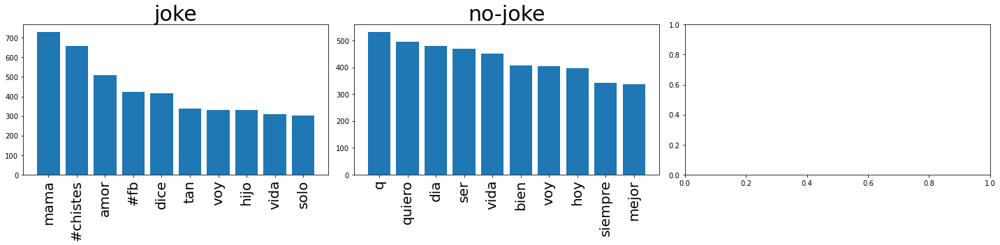

In [20]:
top_words(kl_v, kl_t, height = 5)

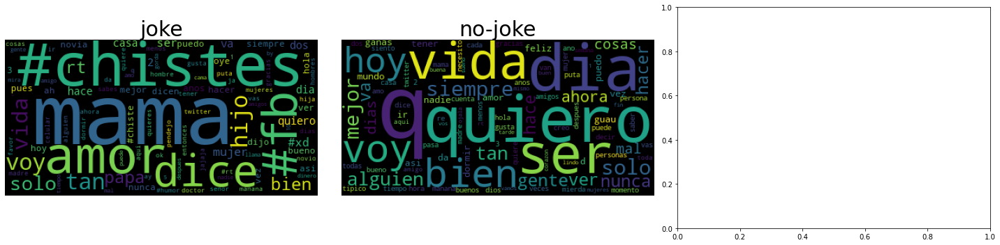

In [21]:
word_clouds(kl_v, kl_t, height = 5)

#### Bigramas por "*klass*"

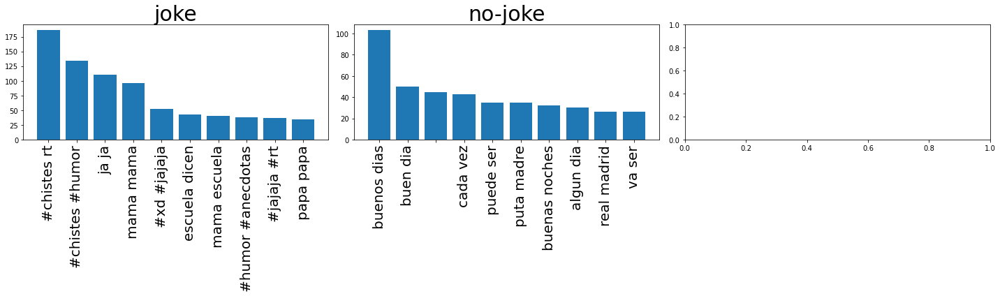

In [22]:
top_words(kl_v_2grams, kl_t_2grams, height = 6)

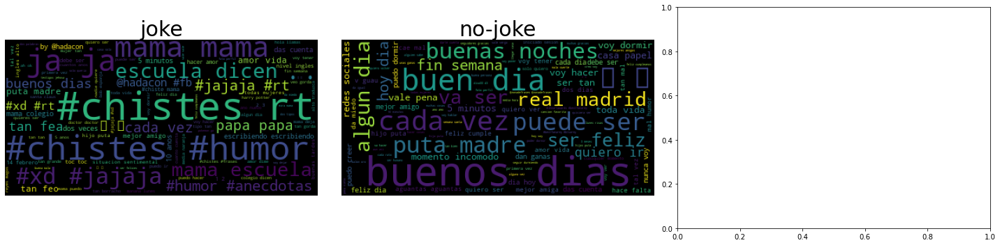

In [23]:
word_clouds(kl_v_2grams, kl_t_2grams, height = 5)

#### Unigramas por "*humor_mechanism*"

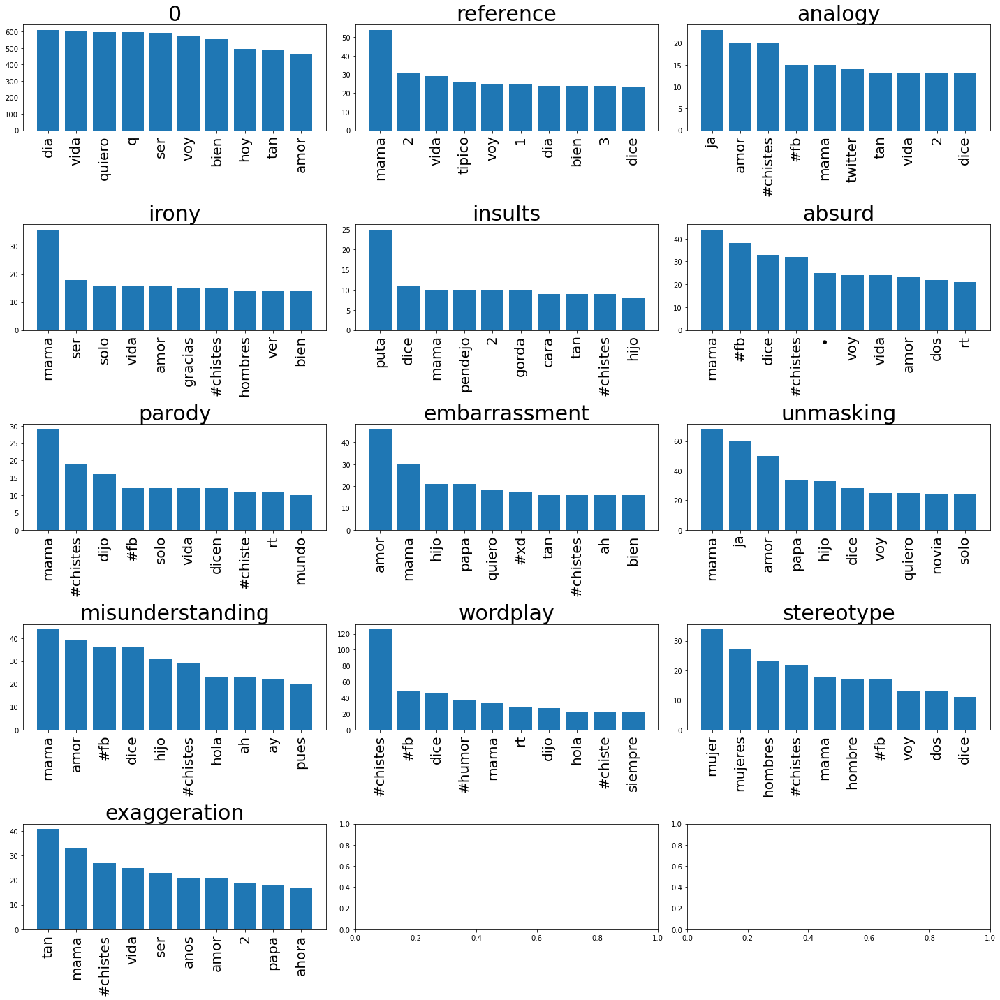

In [24]:
top_words(hm_v, hm_t, height = 20)

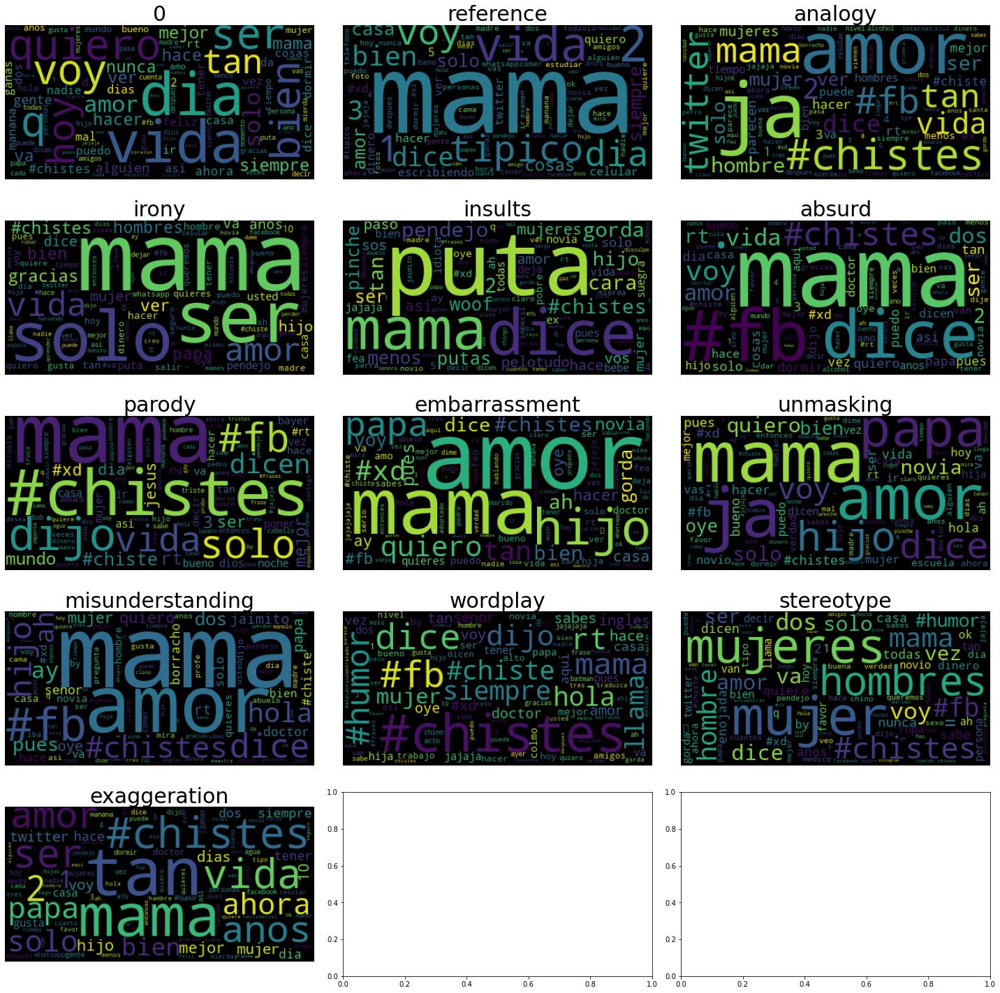

In [25]:
word_clouds(hm_v, hm_t, height = 20)

#### Bigramas por "*humor_mechanism*"

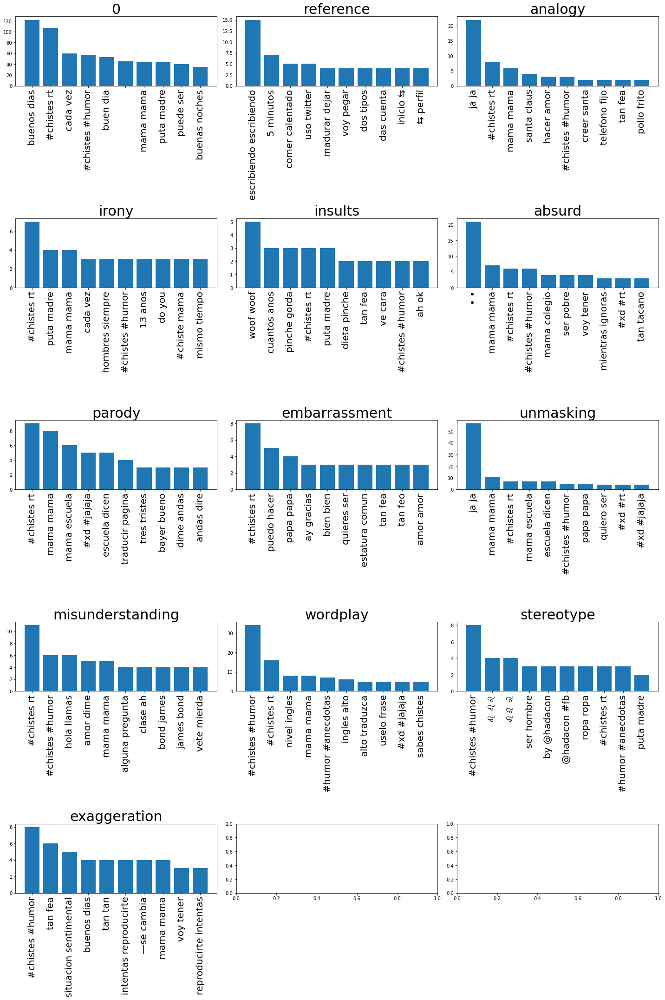

In [26]:
top_words(hm_v_2grams, hm_t_2grams, height = 30)

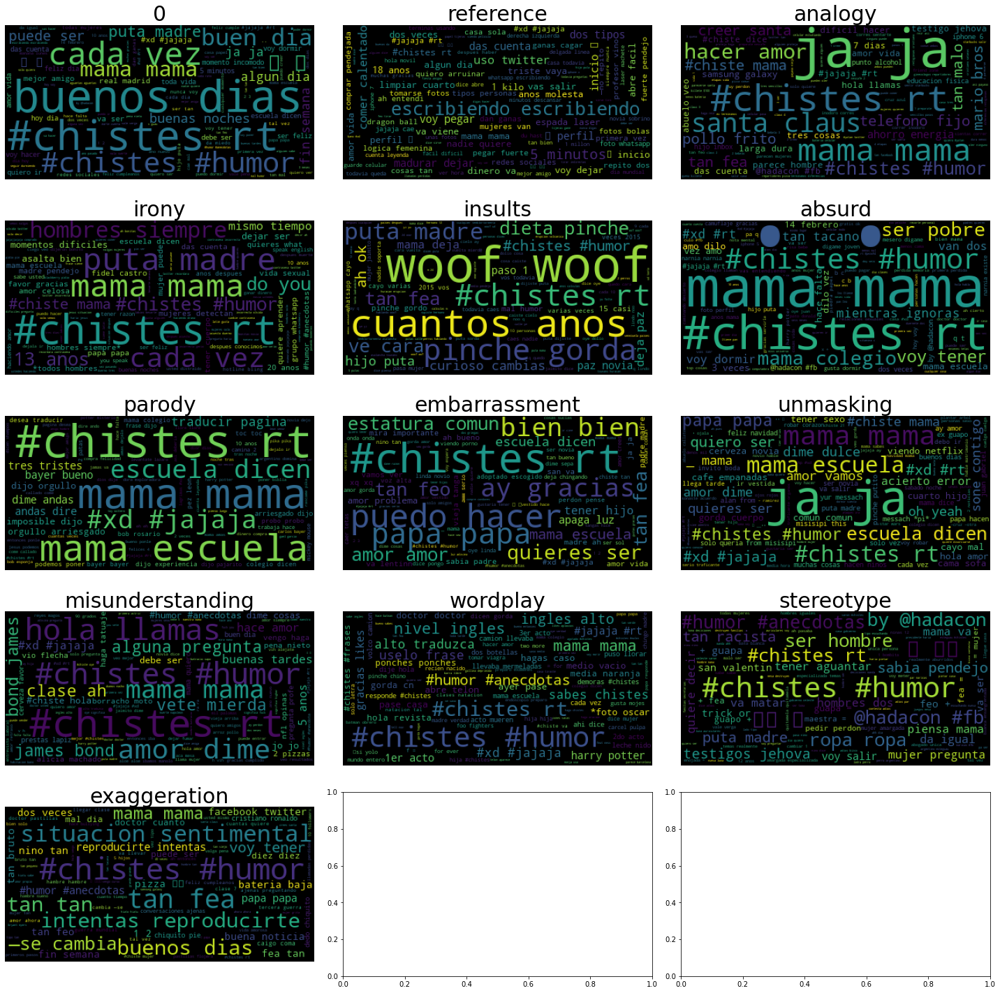

In [27]:
word_clouds(hm_v_2grams, hm_t_2grams, height = 20)

#### Unigramas por "*discrete_humor_rating*"

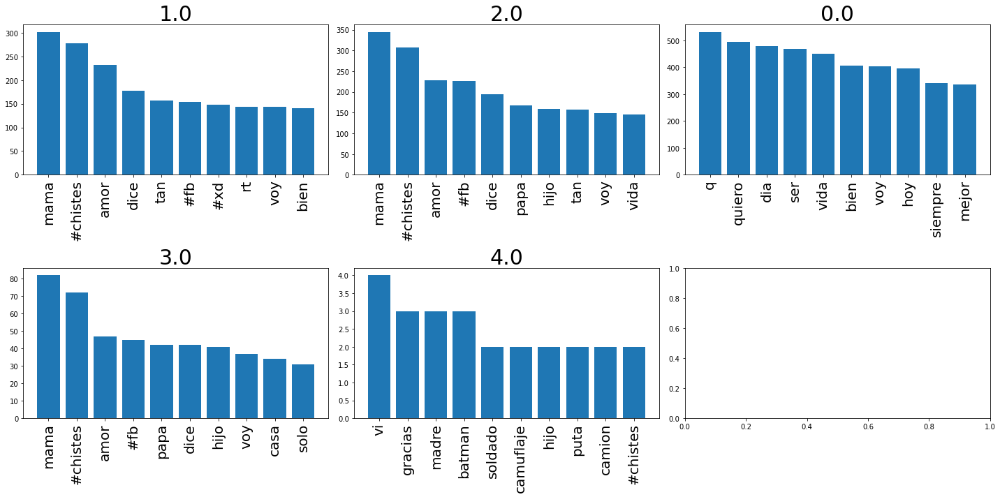

In [28]:
top_words(hr_v, hr_t)

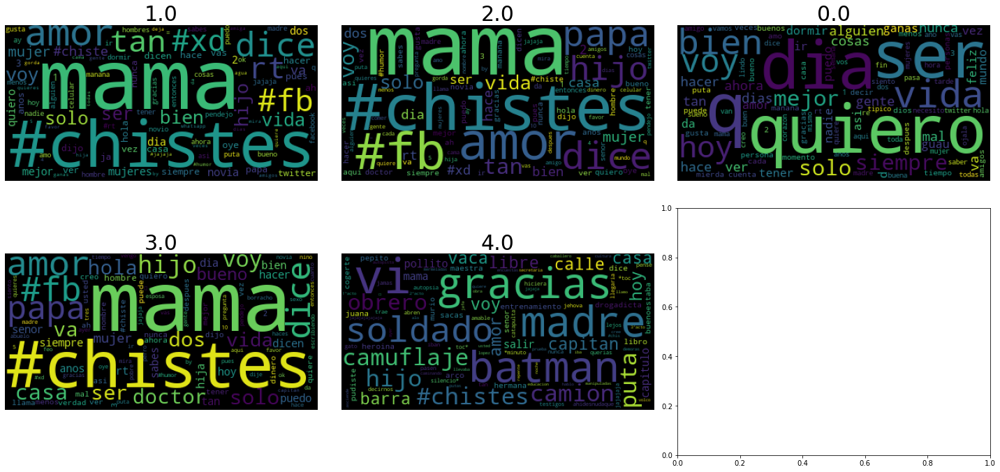

In [29]:
word_clouds(hr_v, hr_t, height = 10)

#### Bigramas por "*discrete_humor_rating*"

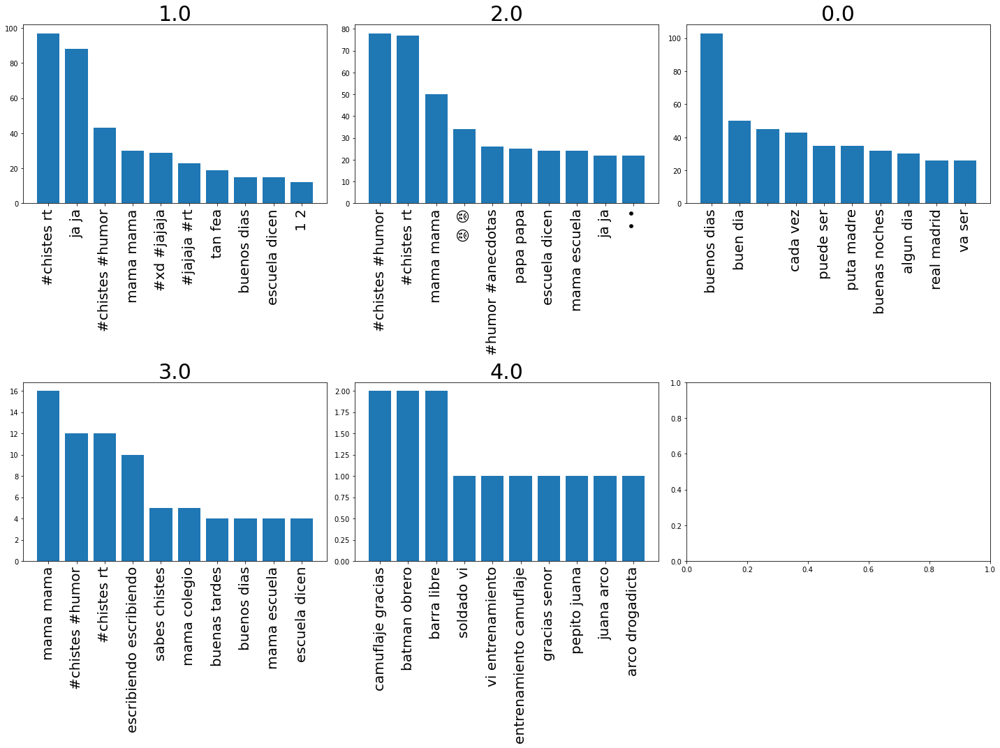

In [30]:
top_words(hr_v_2grams, hr_t_2grams, height =15)

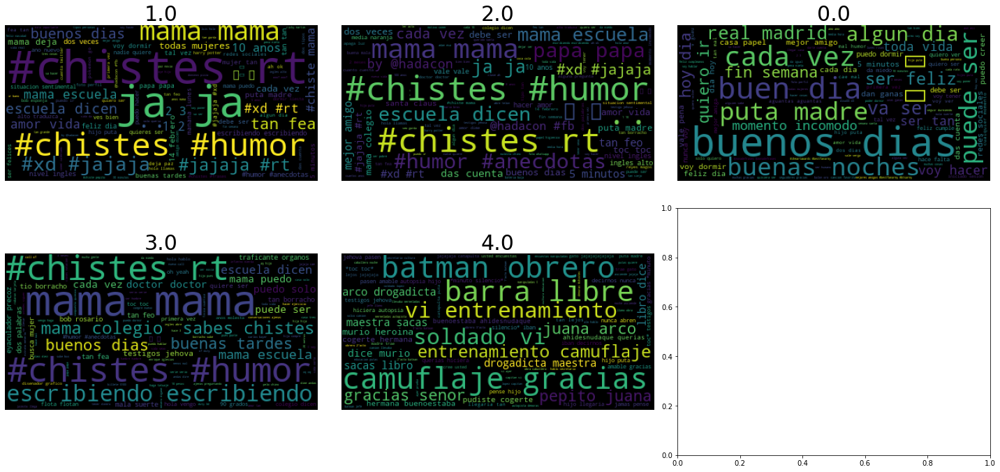

In [31]:
word_clouds(hr_v_2grams, hr_t_2grams, height = 10)

### TF-IDF

#### Unigramas por "*klass*"

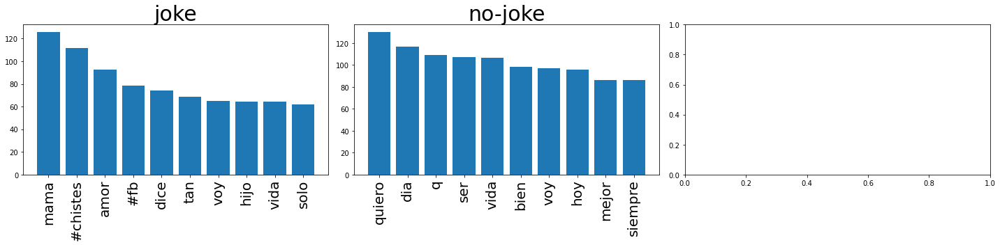

In [32]:
top_words(kl_v_tfidf, kl_t_tfidf, height = 5)

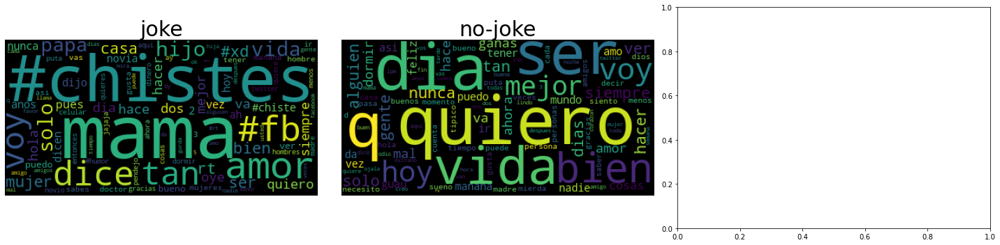

In [33]:
word_clouds(kl_v_tfidf, kl_t_tfidf, height = 5)

#### Bigramas por "*klass*"

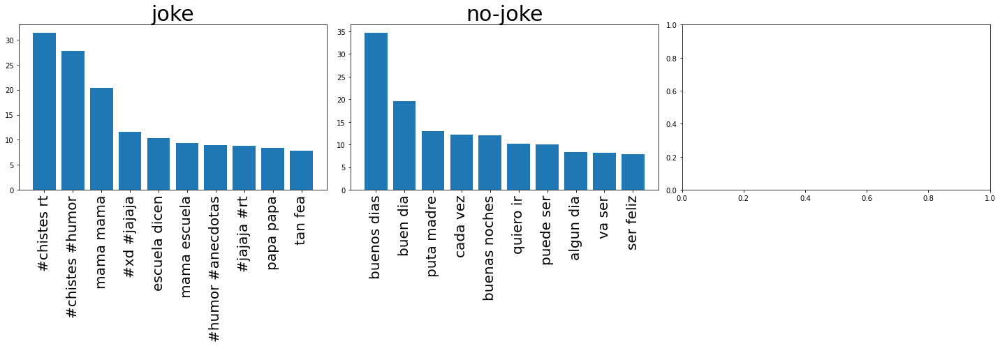

In [34]:
top_words(kl_v_2grams_tfidf, kl_t_2grams_tfidf, height = 7)

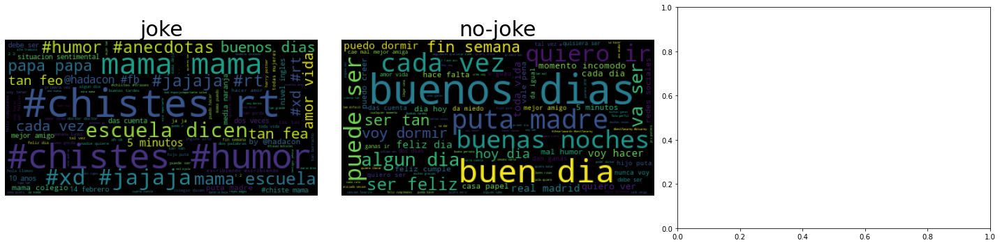

In [35]:
word_clouds(kl_v_2grams_tfidf, kl_t_2grams_tfidf, height = 5)

#### Unigramas por "*humor_mechanism*"

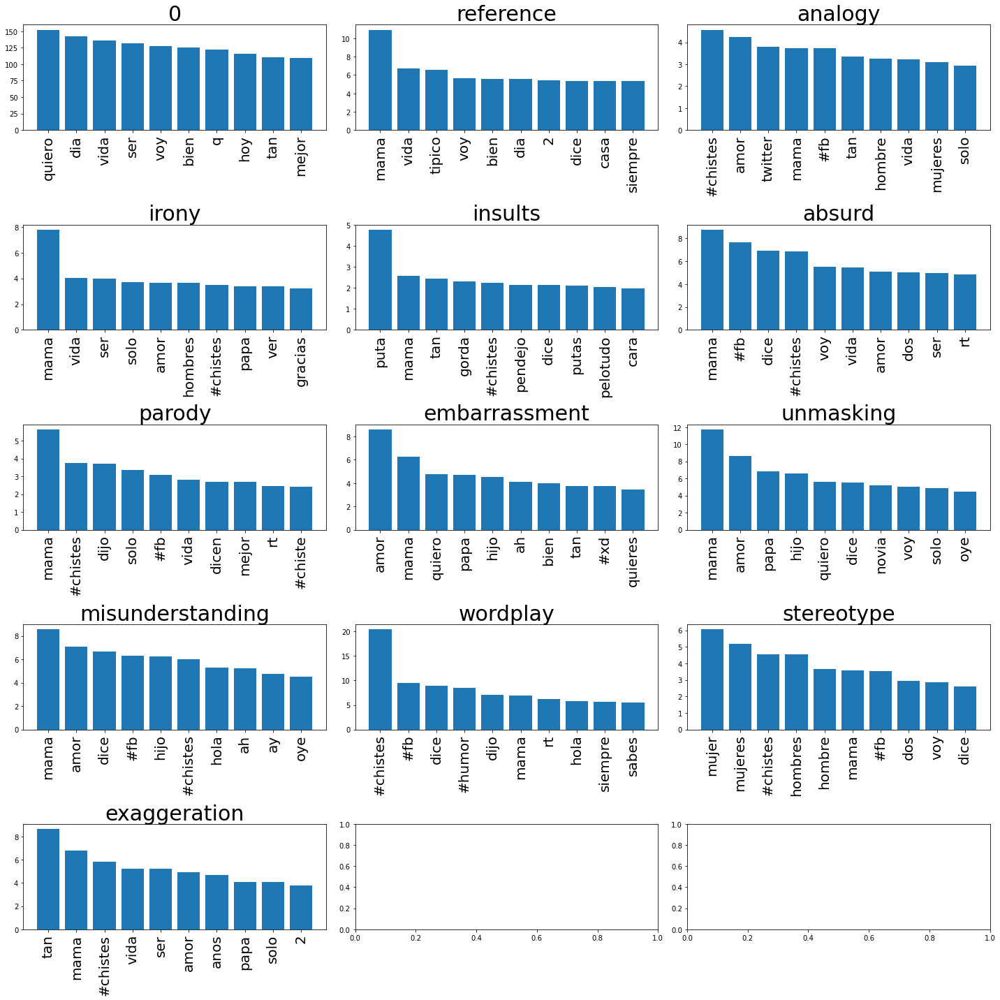

In [36]:
top_words(hm_v_tfidf, hm_t_tfidf, height = 20)

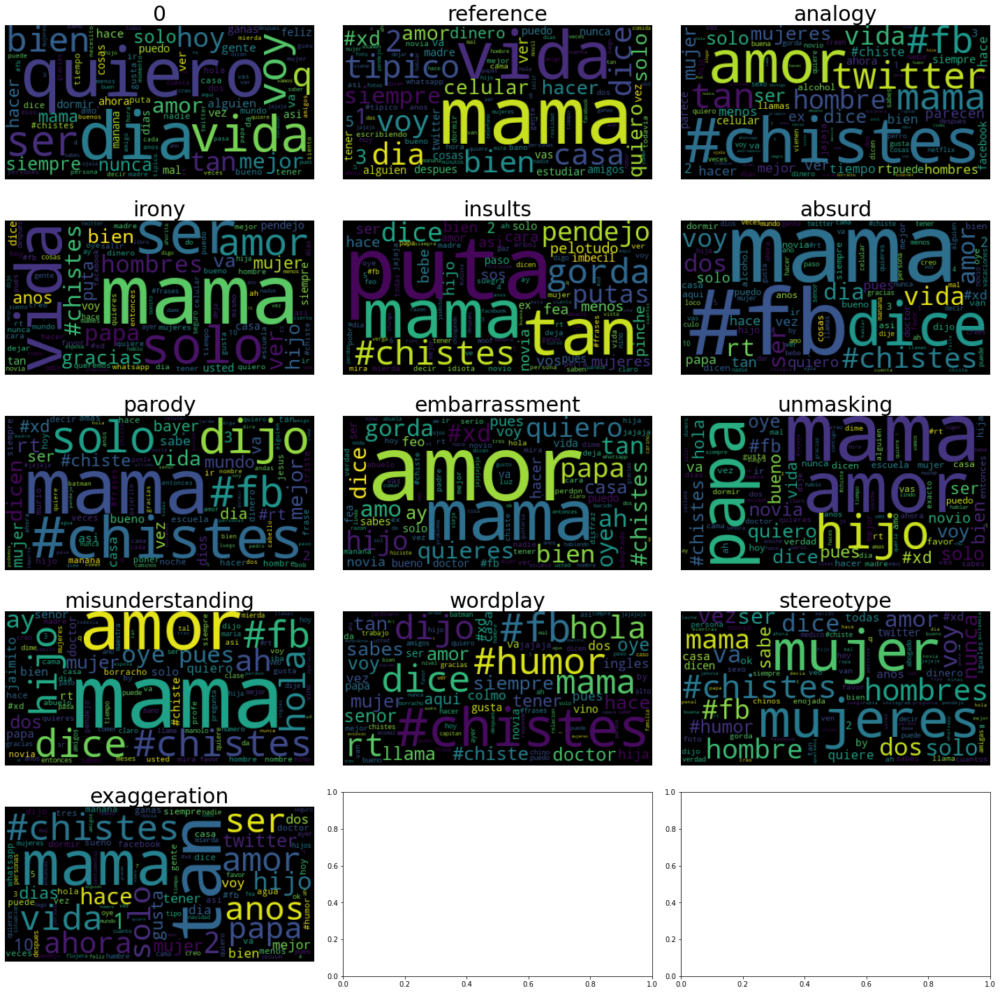

In [37]:
word_clouds(hm_v_tfidf, hm_t_tfidf, height = 20)

#### Bigramas por "*humor_mechanism*"

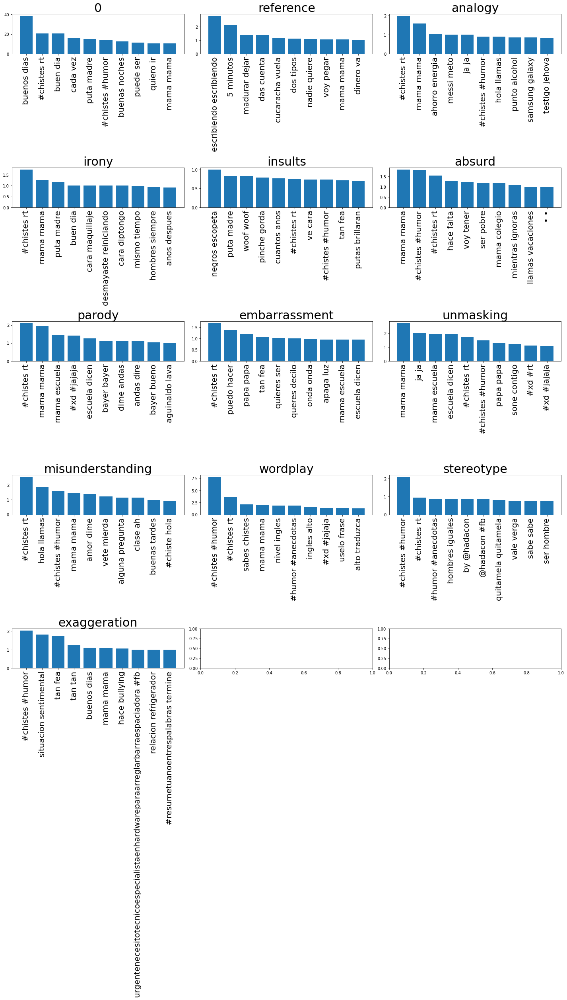

In [38]:
top_words(hm_v_2grams_tfidf, hm_t_2grams_tfidf, height = 35)

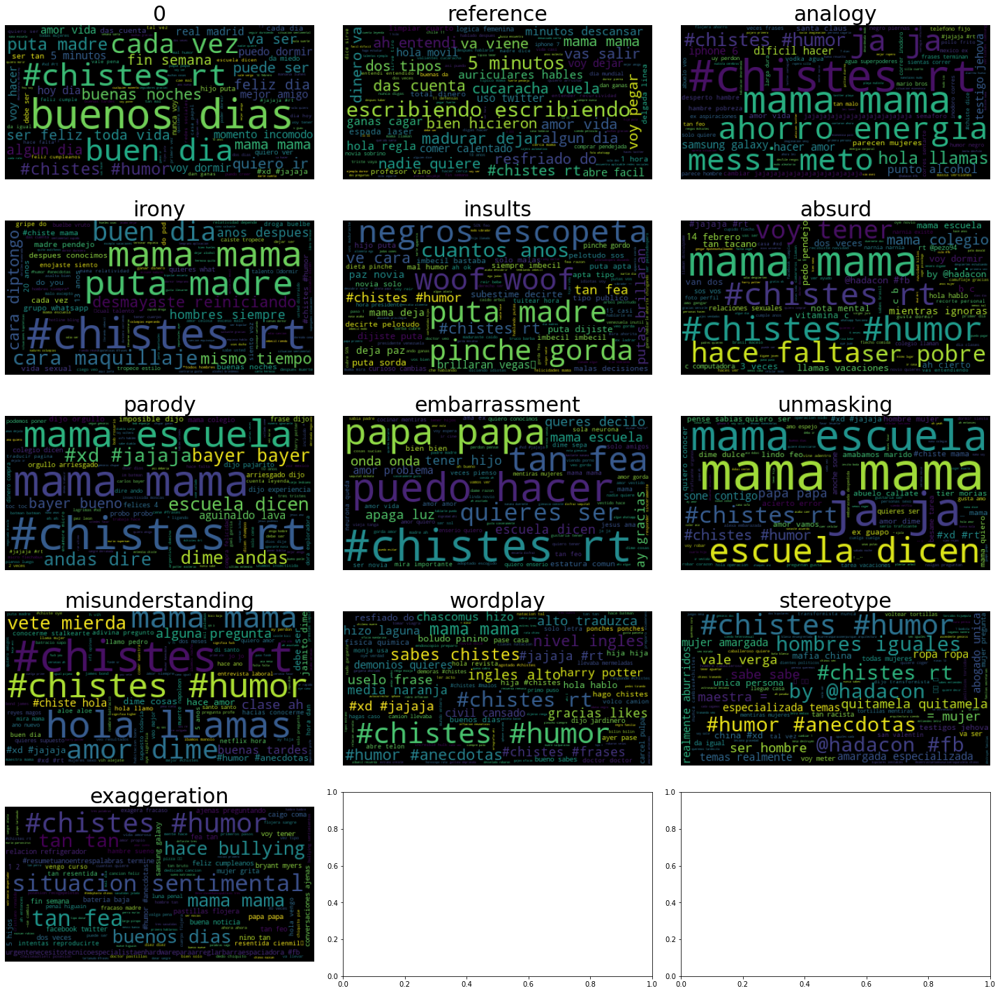

In [39]:
word_clouds(hm_v_2grams_tfidf, hm_t_2grams_tfidf, height = 20)

#### Unigramas por "*discrete_humor_rating*"

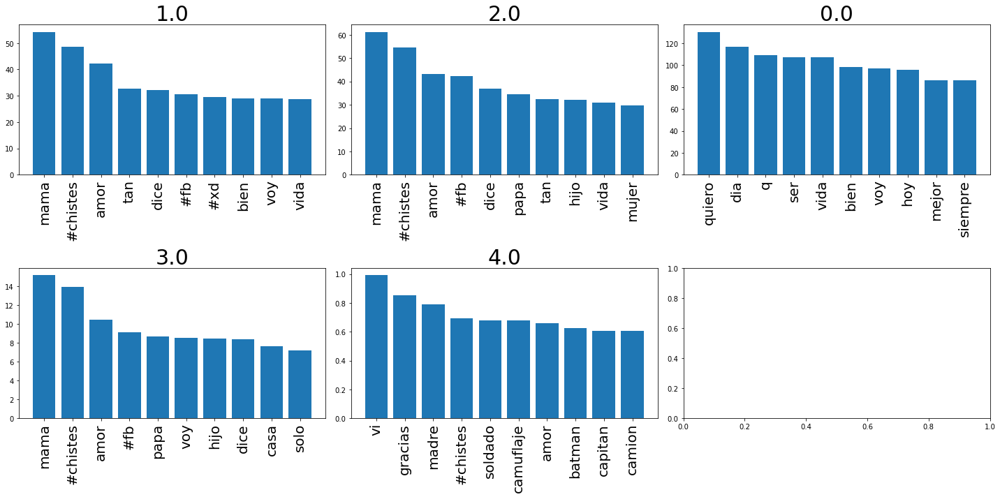

In [40]:
top_words(hr_v_tfidf, hr_t_tfidf)

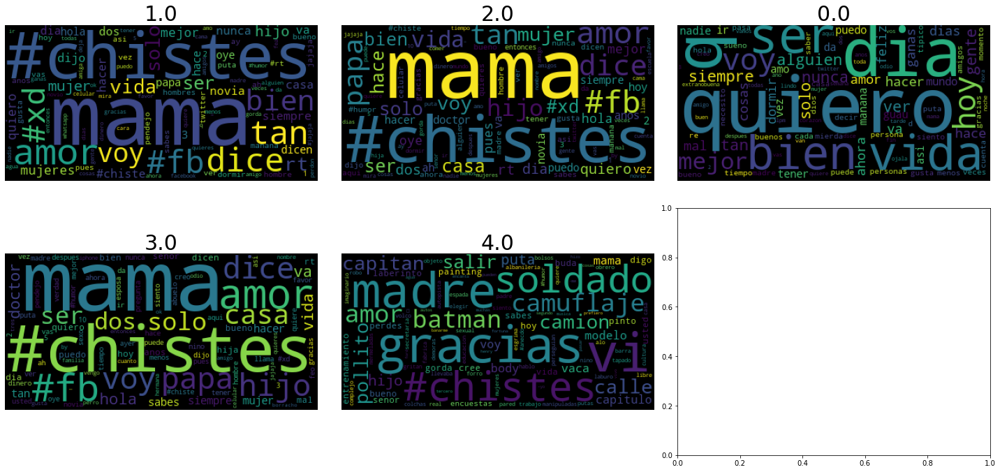

In [41]:
word_clouds(hr_v_tfidf, hr_t_tfidf, height = 10)

#### Bigramas por "*discrete_humor_rating*"

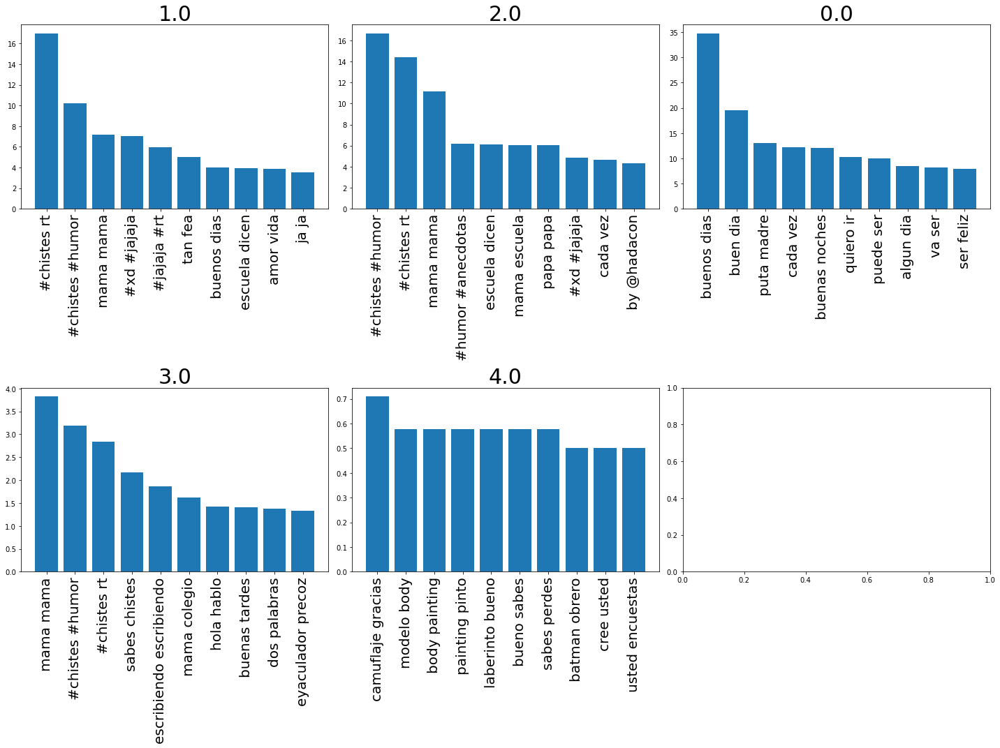

In [42]:
top_words(hr_v_2grams_tfidf, hr_t_2grams_tfidf, height = 15)

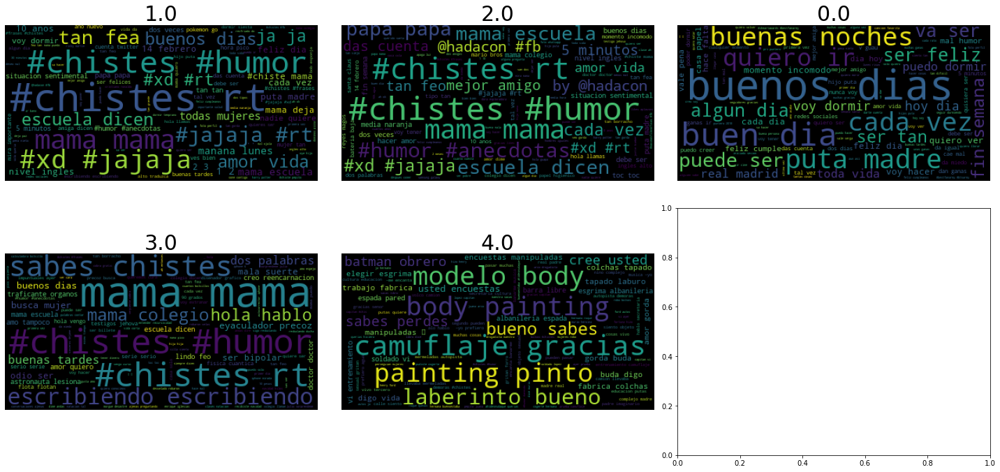

In [43]:
word_clouds(hr_v_2grams_tfidf, hr_t_2grams_tfidf, height = 10)

## 3. Reducción de dimensiones por LatentDirichletAllocation y TruncateSVD

### 3.1. Reducción de dimensión mediante LatentDirichletAllocation
En el siguiente código se hará la reducción de dimensiones a 14 tópicos, para unigramas y bigramas

In [44]:
ldia_onegram, ldia_transform_onegram = execute_LDiA(data[data["humor_mechanism"] != 0], "humor_mechanism", "text")

In [45]:
ldia_bigram, ldia_transform_bigram = execute_LDiA(data[data["humor_mechanism"] != 0], "humor_mechanism", "text", ngrams = 2)

C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn("The parameter 'token_pattern' will not be used"


### 3.2. Reducción de dimensión mediante TruncateSVD
En el siguiente código se hará la reducción de dimensiones a 14 tópicos, para unigramas y bigramas

In [46]:
svd_onegram, svd_transform_onegram = execute_TruncatedSVD(data[data["humor_mechanism"] != 0], "humor_mechanism", "text")

C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn("The parameter 'token_pattern' will not be used"


In [47]:
svd_bigram, svd_transform_bigram = execute_TruncatedSVD(data[data["humor_mechanism"] != 0], "humor_mechanism", "text", ngrams = 2)

## 4. Elección de el número de tópicos >  humor_mechanism + 1
Sabiendo que todo twit sin `humor_mechanism` definido tendrá un valo de 0, entonces al total de los mecanismos le sumaremos 1 para obtener el valor mínimo requerido por los ejercicios.

In [48]:
print("Elección de número de tópicos: ", len(data.humor_mechanism.value_counts()) + 1)

Elección de número de tópicos:  14


## 5. Determinación del tópico de cada tweet basado en los grupos obtenidos para cada tema y sus 10 palabras más frecuentes
En las siguientes celdas veremos el top 10 de las palabras más frecuentas y la nube de las 100 palabras con el mayor score por tópico. Ambos análisis se harán por unigramas y bigramas.

### Análisis por LatentDirichletAllocation para unigramas

C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 128131 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 127995 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 150 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning: Glyph 128131 missing from current font.
  font.set_text(s, 0, flags=flags)
C:\Users\ismedina\Anaconda3\envs\mcdi_2021_02_analisis\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning: Glyph 127995 missing from current font.
  font.set_t

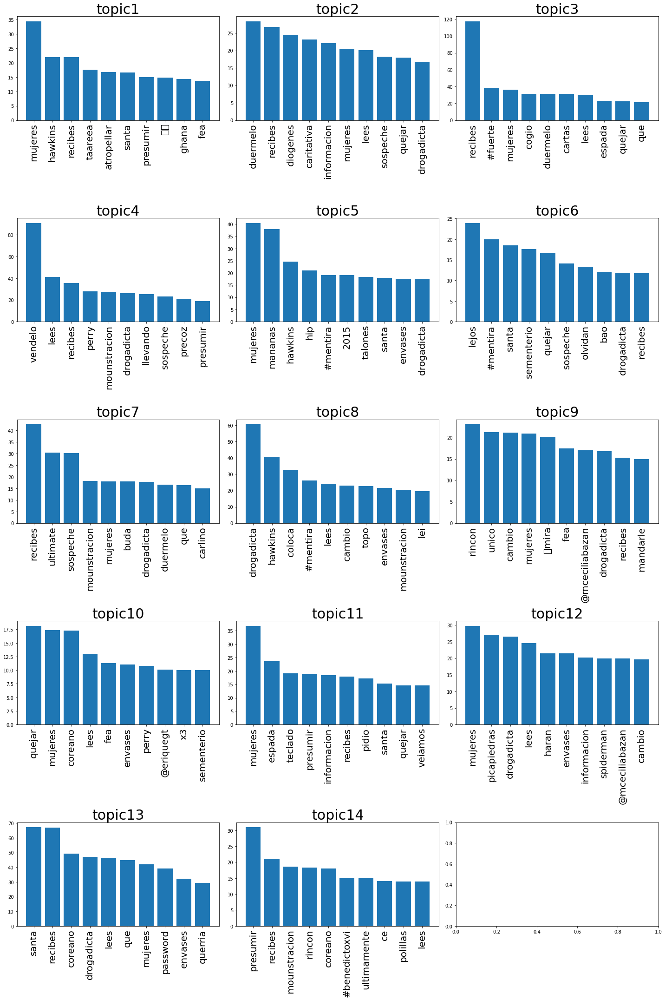

In [49]:
top_words_DF(ldia_onegram)

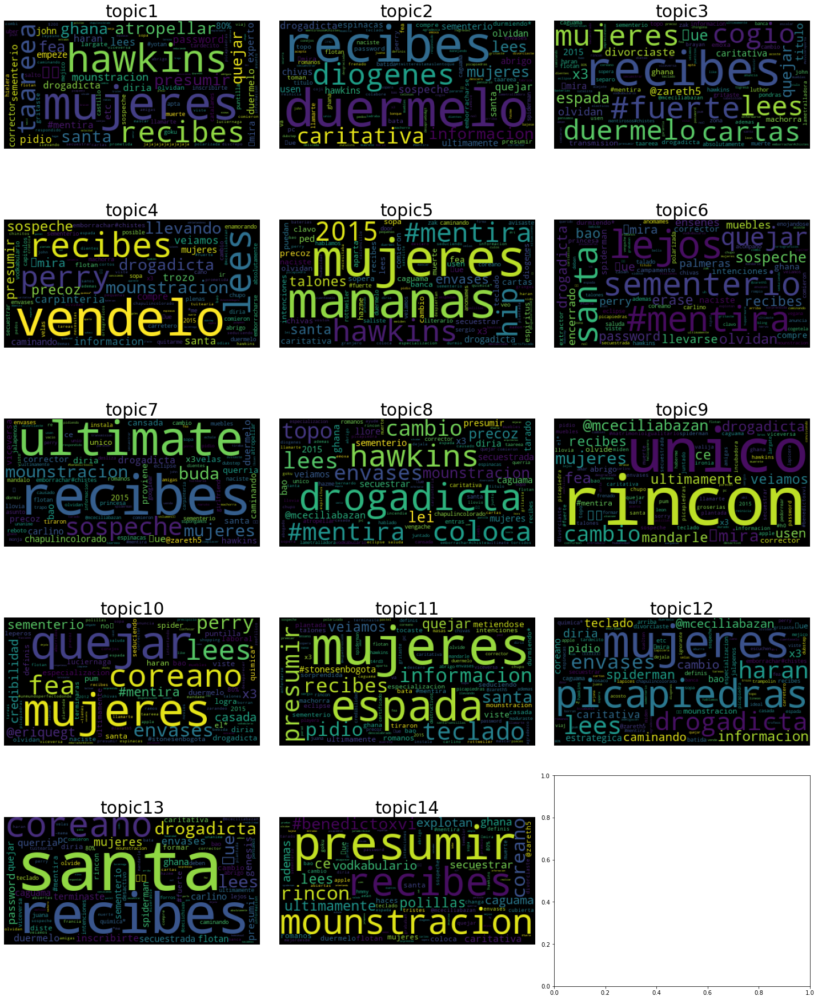

In [50]:
word_clouds_DF(ldia_onegram)

Es notable que al ejecutar LatentDirichletAllocation para unigramas con 14 tópicos no podemos definir un tópico en particular. Intentaremos con bigramas.

### Análisis por LatentDirichletAllocation para bigramas

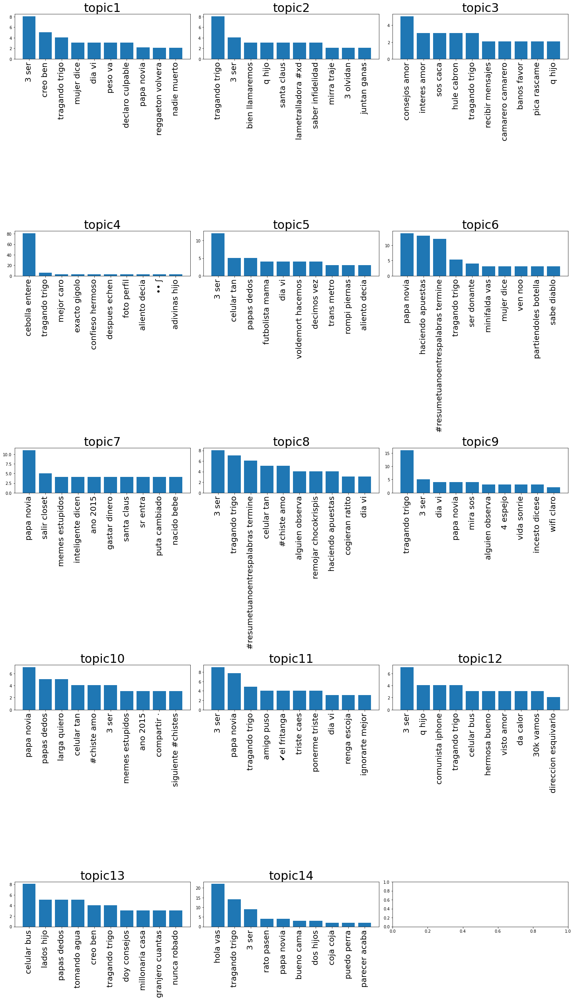

In [51]:
top_words_DF(ldia_bigram, height = 35)

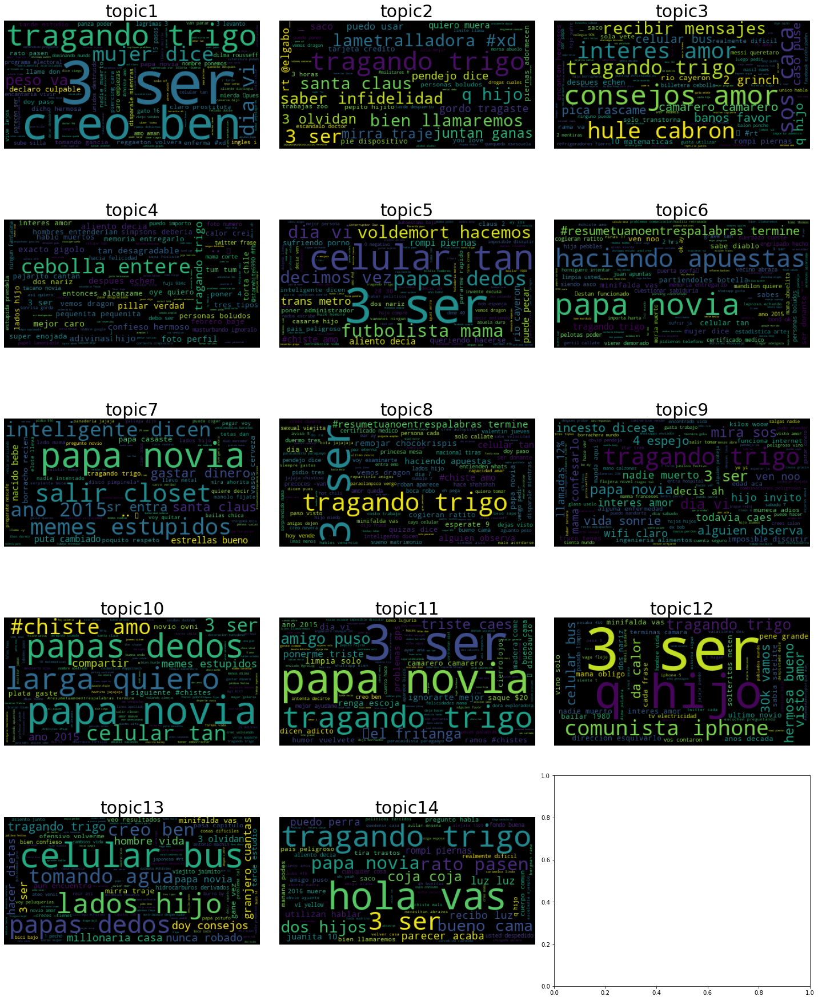

In [52]:
word_clouds_DF(ldia_bigram)

Es notable que al ejecutar LatentDirichletAllocation para bigramas con 14 tópicos no podemos definir un tópico en particular aún.

### Análisis por TruncateSVD para unigramas

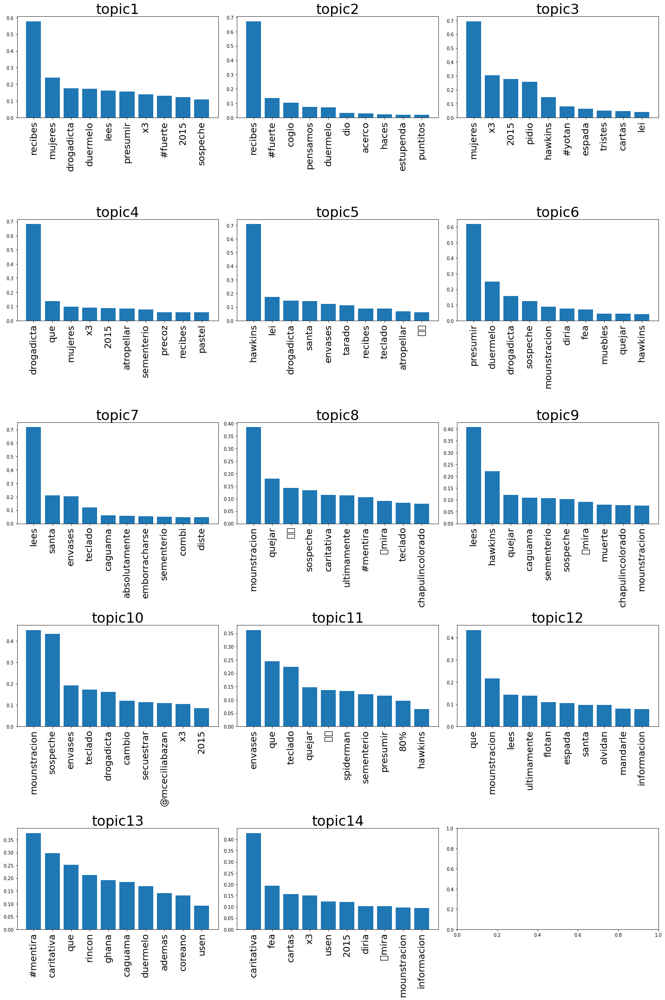

In [53]:
top_words_DF(svd_onegram)

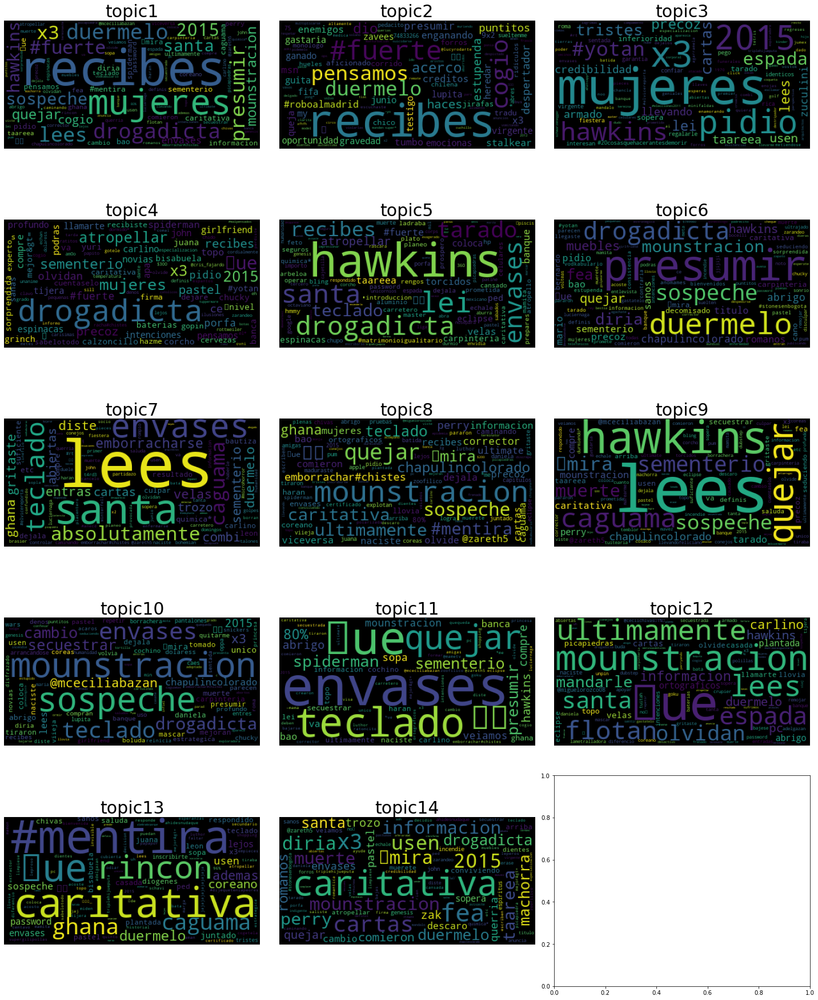

In [54]:
word_clouds_DF(svd_onegram)

Es notable que al ejecutar TruncateSVD para unigramas con 14 tópicos no podemos definir un tópico en particular. Intentaremos con bigramas.

### Análisis por TruncateSVD para bigramas

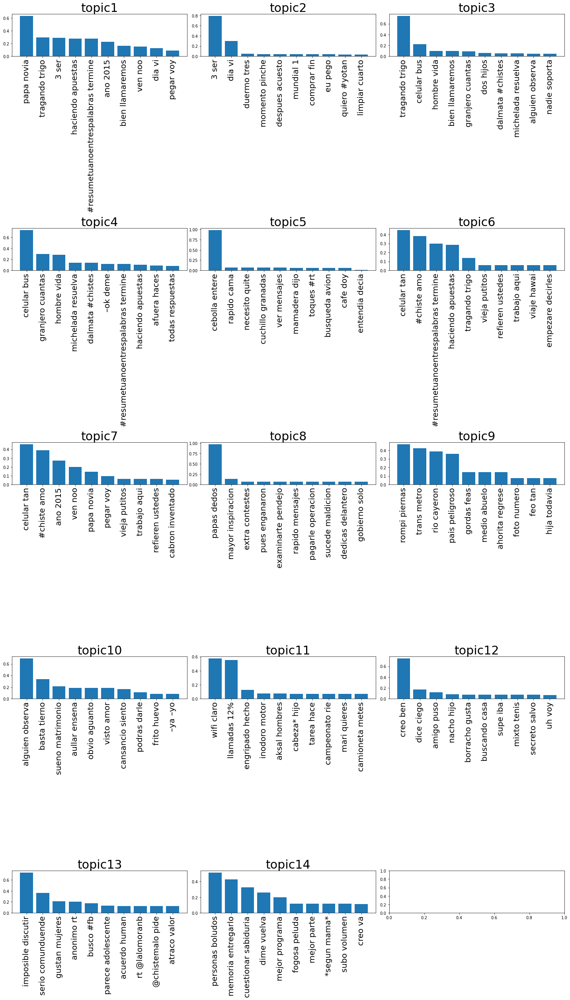

In [55]:
top_words_DF(svd_bigram, height = 35)

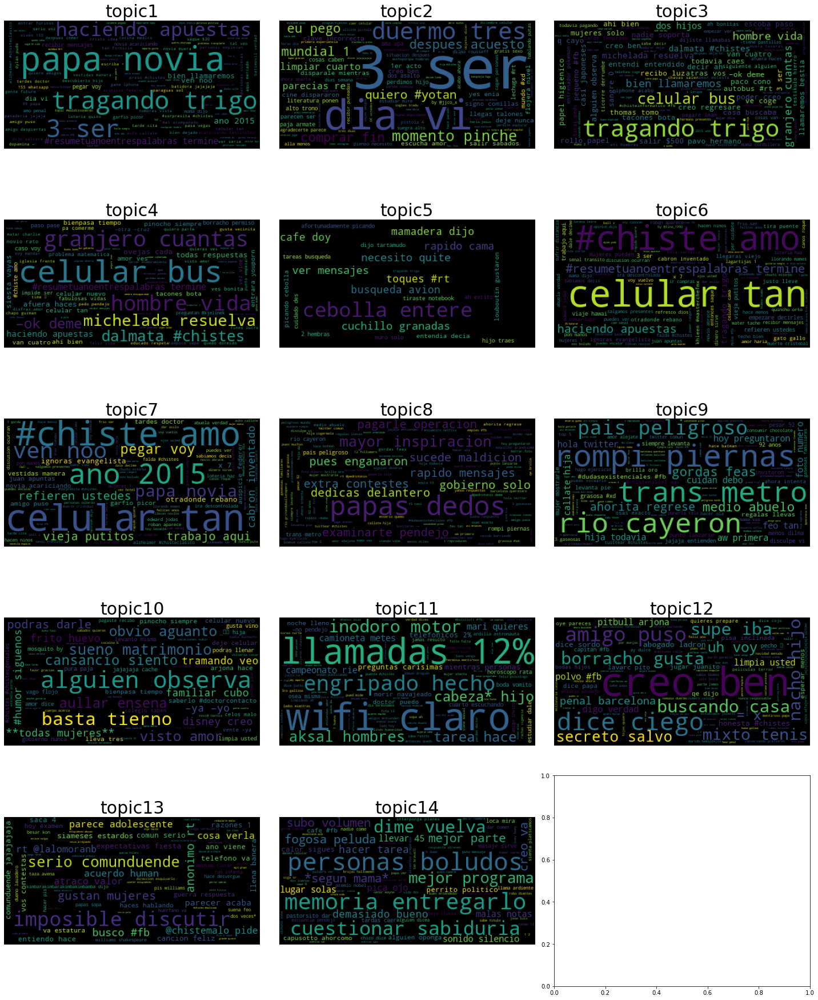

In [56]:
word_clouds_DF(svd_bigram)

Es notable que al ejecutar TruncateSVD para bigramas con 14 tópicos no podemos definir un tópico en particular aún.

## 6.1. Identificación de los temas en cada una de las clases y comparación de resultados entre LSA y LDiA.
Para poder comparar LSA y LDiA, vamos a agregar en el DataFrame origen el tópico más probable para **LatentDirichletAllocation** y **TruncateSVD**. El código está inspirado en (Sinivasan, 2020) [1].

In [57]:
df_comparisons = data[data["humor_mechanism"] != 0].copy()

In [58]:
df_comparisons["Topic_LDiA_1Gram"] = ldia_transform_onegram.argmax(axis = 1)
df_comparisons["Topic_LDiA_2Gram"] = ldia_transform_bigram.argmax(axis = 1)
df_comparisons["Topic_SVD_1Gram"] = svd_transform_onegram.argmax(axis = 1)
df_comparisons["Topic_SVD_2Gram"] = svd_transform_bigram.argmax(axis = 1)

In [59]:
display(df_comparisons[["text", "humor_mechanism", "Topic_LDiA_1Gram"]])

,text,humor_mechanism,Topic_LDiA_1Gram
id,,,
tweet13,#20CosasQueHacerAntesDeMorir: Enseñarles la di...,reference,11
tweet21,Te quiero pero #YoTan Twitter y tú tan Facebook.,analogy,5
tweet22,"-El alcohol es un veneno. –Si es un veneno, ¿P...",reference,7
tweet23,Cambié mi contraseña de Twitter por ''incorrec...,irony,11
tweet29,WhatsApp cayó varias veces en 2015 y vos todav...,insults,7
...,...,...,...
tweet23974,"Doctor, no levanto la cabeza, no hablo con la ...",misunderstanding,2
tweet23984,Que me parta un rayo (Un Siamés) #CHISTES,irony,12
tweet23985,Cualquier cosa que hagas da siempre el 100%\n\...,wordplay,0


De acuerdo al tópico asignado a **tweet23** y a **tweet23994**, las estadísticas de palabras y las nubes de las mismas, se logra identificar que la cantidad de tópicos creados por **LDiA** con unigramas quizá aún es pequeña para definir tópicos de humor claramente separables. 

In [60]:
display(df_comparisons[["text", "humor_mechanism", "Topic_LDiA_2Gram"]])

,text,humor_mechanism,Topic_LDiA_2Gram
id,,,
tweet13,#20CosasQueHacerAntesDeMorir: Enseñarles la di...,reference,2
tweet21,Te quiero pero #YoTan Twitter y tú tan Facebook.,analogy,10
tweet22,"-El alcohol es un veneno. –Si es un veneno, ¿P...",reference,11
tweet23,Cambié mi contraseña de Twitter por ''incorrec...,irony,3
tweet29,WhatsApp cayó varias veces en 2015 y vos todav...,insults,5
...,...,...,...
tweet23974,"Doctor, no levanto la cabeza, no hablo con la ...",misunderstanding,13
tweet23984,Que me parta un rayo (Un Siamés) #CHISTES,irony,10
tweet23985,Cualquier cosa que hagas da siempre el 100%\n\...,wordplay,4


De acuerdo al tópico asignado a **tweet22** y a **tweet23994**, las estadísticas de palabras y las nubes de las mismas, se logra identificar que la cantidad de tópicos creados por **LDiA** con bigramas quizá aún es pequeña para definir tópicos de humor claramente separables. 

In [61]:
display(df_comparisons[["text", "humor_mechanism", "Topic_SVD_1Gram"]])

,text,humor_mechanism,Topic_SVD_1Gram
id,,,
tweet13,#20CosasQueHacerAntesDeMorir: Enseñarles la di...,reference,0
tweet21,Te quiero pero #YoTan Twitter y tú tan Facebook.,analogy,4
tweet22,"-El alcohol es un veneno. –Si es un veneno, ¿P...",reference,0
tweet23,Cambié mi contraseña de Twitter por ''incorrec...,irony,0
tweet29,WhatsApp cayó varias veces en 2015 y vos todav...,insults,0
...,...,...,...
tweet23974,"Doctor, no levanto la cabeza, no hablo con la ...",misunderstanding,0
tweet23984,Que me parta un rayo (Un Siamés) #CHISTES,irony,2
tweet23985,Cualquier cosa que hagas da siempre el 100%\n\...,wordplay,12


De acuerdo al tópico asignado a **tweet22**, **tweet23** y a **tweet29**, las estadísticas de palabras y las nubes de las mismas, se logra identificar que la cantidad de tópicos creados por **TruncateSVD** con unigramas quizá aún es pequeña para definir tópicos de humor claramente separables. 

In [62]:
display(df_comparisons[["text", "humor_mechanism", "Topic_SVD_2Gram"]])

,text,humor_mechanism,Topic_SVD_2Gram
id,,,
tweet13,#20CosasQueHacerAntesDeMorir: Enseñarles la di...,reference,5
tweet21,Te quiero pero #YoTan Twitter y tú tan Facebook.,analogy,10
tweet22,"-El alcohol es un veneno. –Si es un veneno, ¿P...",reference,12
tweet23,Cambié mi contraseña de Twitter por ''incorrec...,irony,13
tweet29,WhatsApp cayó varias veces en 2015 y vos todav...,insults,13
...,...,...,...
tweet23974,"Doctor, no levanto la cabeza, no hablo con la ...",misunderstanding,2
tweet23984,Que me parta un rayo (Un Siamés) #CHISTES,irony,13
tweet23985,Cualquier cosa que hagas da siempre el 100%\n\...,wordplay,13


De acuerdo al tópico asignado a **tweet21**, **tweet22** y a **tweet23985**, las estadísticas de palabras y las nubes de las mismas, se logra identificar que la cantidad de tópicos creados por **TruncateSVD** con bigramas quizá aún es pequeña para definir tópicos de humor claramente separables. 

# Conclusiones
Los análisis de texto resultan en herramientas muy útiles.

* Es importante trabajar no sólo con unigramas sino con $n$-gramas que permitan un mejor análisis de asignación por tópicos y experimentar con una gran cantidad de tópicos dado que se nota una gran diversidad de temas sobre los que los twits tratan.
* Las nubes de palabras y el conteo de palabras dan gran noción del conjunto de datos que se está trabajando, tanto para **BoW** y **TF-IDF** como para dimensiones reducidas por **LDiA** y **TruncateSVD**.

# Referencias
1. Sinivasan, P. (17 de Julio de 2020). Topic Modeling in Python : Using Latent Dirichlet Allocation (LDA). Obtenido de medium.com: https://medium.com/@prashanthsri12/topic-modeling-in-python-using-latent-dirichlet-allocation-lda-61001ba51124